<a href="https://colab.research.google.com/github/deepakshekhawat1209/BikeSharingDemand/blob/main/machine_learning_capstone_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## <b> Problem Description </b>

### Currently Rental bikes are introduced in many urban cities for the enhancement of mobility comfort. It is important to make the rental bike available and accessible to the public at the right time as it lessens the waiting time. Eventually, providing the city with a stable supply of rental bikes becomes a major concern. The crucial part is the prediction of bike count required at each hour for the stable supply of rental bikes.


# **Bussiness Context**


# The increased usage of private vehicles in metropolitan areas has resulted in significant rise in fuel consumption’s that have adverse effect on the climate. It has led people in today’s society to accept problems like road traffic as the norm. Therefore the government and organizations started adopting measures to facilitate sustainable development to address the issue. 
# Many countries have bike sharing system, such as bike sharing system in South Korea, which started to overcome all this issues and to develop a healthy environment for citizen of Seoul to live. In that context, the Bike Share initiative was launched to tackle the public mobility problem. It provided the people with an alternative to using a sustainable mode of transport for a small distance at a minimal cost. And gave people the freedom to utilize the service by themselves. In a bike-share system, a user could lend a bike from any bike stations and return it to a bike station near the destination and since it involves the activity of pedaling the bike it has beneficial health effects. And the city-wide installation of bike stations improved the accessibility of areas by bikes. Docking stations are computerized stands for the purpose of pickup and drop off of the rental bikes. Users of public bikes can rent and return rental bikes at any docking station.
# With this kind of smart technology and convenience, the use of Rental bike is increasing every day. So, there is a need to manage the bike rental demand and manage the continuous and convenient service for the users. This study proposes a data mining-based approach including weather data to predict whole city public bike demand. A rule-based model is used to predict the number of rental bikes needed at each hour.


# **Data Description:**
# The dataset contains weather information (Temperature, Humidity, Windspeed, Visibility, Dewpoint, Solar radiation, Snowfall, Rainfall), the number of bikes rented per hour and date information.

# **Attribute Information:**
• Date : year-month-day

• Rented Bike count - Count of bikes rented at each hour

• Hour - Hour of the day

• Temperature-Temperature in Celsius

• Humidity - %

• Windspeed - m/s

• Visibility - 10m

• Dew point temperature - Celsius

• Solar radiation - MJ/m2

• Rainfall - mm

• Snowfall - cm

• Seasons - Winter, Spring, Summer, Autumn

• Holiday - Holiday/No holiday

• Functional Day - NoFunc(Non Functional Hours), Fun(Functional hours)



#Importing useful libraries

In [ ]:
#let us first import various useful libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import math

In [ ]:
#Mounting google drive:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# now read the data by using pandas function
data = pd.read_csv('/content/drive/MyDrive/AlmaBetter/modules/capstone_project/regression/Copy of SeoulBikeData.csv',encoding= 'unicode_escape')

#Exploratory Data Analysis

In [ ]:
# let us examine what is inside data
data.head()

,Date,Rented Bike Count,Hour,Temperature(°C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(°C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Seasons,Holiday,Functioning Day
0,01/12/2017,254,0,-5.2,37,2.2,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
1,01/12/2017,204,1,-5.5,38,0.8,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
2,01/12/2017,173,2,-6.0,39,1.0,2000,-17.7,0.0,0.0,0.0,Winter,No Holiday,Yes
3,01/12/2017,107,3,-6.2,40,0.9,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
4,01/12/2017,78,4,-6.0,36,2.3,2000,-18.6,0.0,0.0,0.0,Winter,No Holiday,Yes


In [ ]:
# more data insight
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 14 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Date                       8760 non-null   object 
 1   Rented Bike Count          8760 non-null   int64  
 2   Hour                       8760 non-null   int64  
 3   Temperature(°C)            8760 non-null   float64
 4   Humidity(%)                8760 non-null   int64  
 5   Wind speed (m/s)           8760 non-null   float64
 6   Visibility (10m)           8760 non-null   int64  
 7   Dew point temperature(°C)  8760 non-null   float64
 8   Solar Radiation (MJ/m2)    8760 non-null   float64
 9   Rainfall(mm)               8760 non-null   float64
 10  Snowfall (cm)              8760 non-null   float64
 11  Seasons                    8760 non-null   object 
 12  Holiday                    8760 non-null   object 
 13  Functioning Day            8760 non-null   objec

In [ ]:
# let us see how many columns are there in our dataset
data.columns

Index(['Date', 'Rented Bike Count', 'Hour', 'Temperature(°C)', 'Humidity(%)',
       'Wind speed (m/s)', 'Visibility (10m)', 'Dew point temperature(°C)',
       'Solar Radiation (MJ/m2)', 'Rainfall(mm)', 'Snowfall (cm)', 'Seasons',
       'Holiday', 'Functioning Day'],
      dtype='object')

In [ ]:
#let us check if there is duplicacy inside our dataset or not
duplicate=data[data.duplicated()]
duplicate

,Date,Rented Bike Count,Hour,Temperature(°C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(°C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Seasons,Holiday,Functioning Day


In [ ]:
# examining null values inside the dataset
data.isna().sum()

Date                         0
Rented Bike Count            0
Hour                         0
Temperature(°C)              0
Humidity(%)                  0
Wind speed (m/s)             0
Visibility (10m)             0
Dew point temperature(°C)    0
Solar Radiation (MJ/m2)      0
Rainfall(mm)                 0
Snowfall (cm)                0
Seasons                      0
Holiday                      0
Functioning Day              0
dtype: int64

In [ ]:
# let us dive deep into the dataset
data.describe()

,Rented Bike Count,Hour,Temperature(°C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(°C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm)
count,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000
mean,704.602055,11.500000,12.882922,58.226256,1.724909,1436.825799,4.073813,0.569111,0.148687,0.075068
std,644.997468,6.922582,11.944825,20.362413,1.036300,608.298712,13.060369,0.868746,1.128193,0.436746
min,0.000000,0.000000,-17.800000,0.000000,0.000000,27.000000,-30.600000,0.000000,0.000000,0.000000
25%,191.000000,5.750000,3.500000,42.000000,0.900000,940.000000,-4.700000,0.000000,0.000000,0.000000
50%,504.500000,11.500000,13.700000,57.000000,1.500000,1698.000000,5.100000,0.010000,0.000000,0.000000
75%,1065.250000,17.250000,22.500000,74.000000,2.300000,2000.000000,14.800000,0.930000,0.000000,0.000000
max,3556.000000,23.000000,39.400000,98.000000,7.400000,2000.000000,27.200000,3.520000,35.000000,8.800000


#Data Visualization

#Univariate Analysis

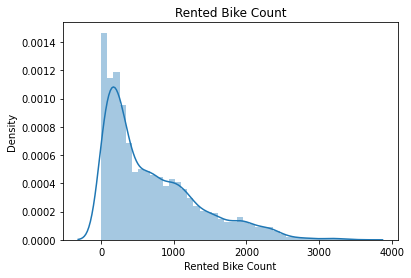

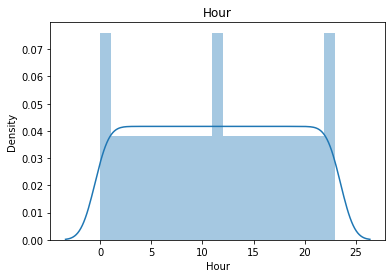

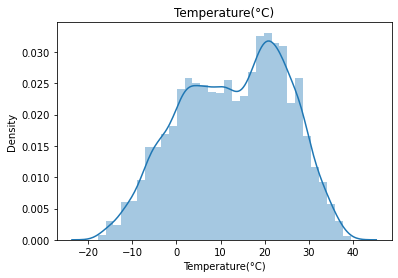

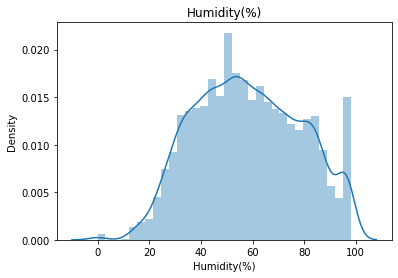

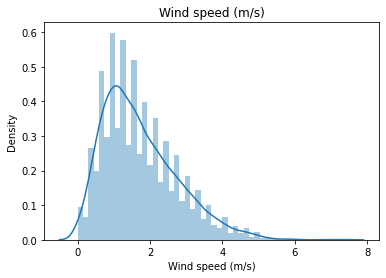

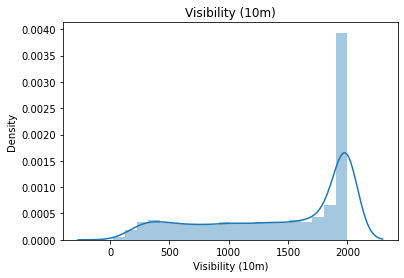

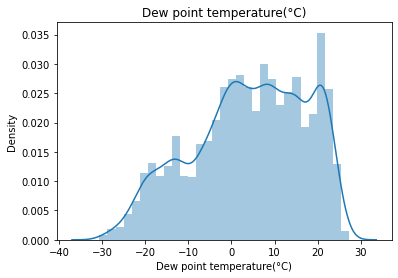

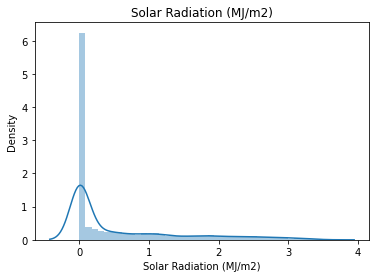

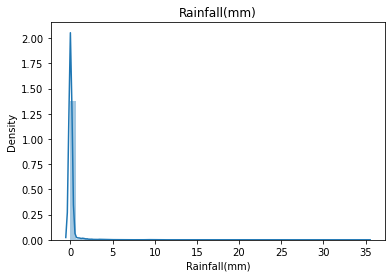

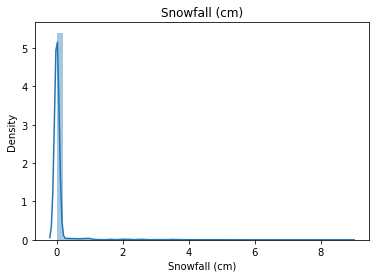

In [ ]:
#let us see the distribution plot of all numerical columns available in our dataset.
for column in data.columns[1:-3]:
    sns.distplot(data[column])
    plt.title(column)
    plt.show()

In [ ]:
data.columns

Index(['Date', 'Rented Bike Count', 'Hour', 'Temperature(°C)', 'Humidity(%)',
       'Wind speed (m/s)', 'Visibility (10m)', 'Dew point temperature(°C)',
       'Solar Radiation (MJ/m2)', 'Rainfall(mm)', 'Snowfall (cm)', 'Seasons',
       'Holiday', 'Functioning Day'],
      dtype='object')

# From the above distribution plot, it is cleared that some of the columns like Wind speed,Rented Bike Count,Solar Radiation  are showing right skeweness and visibility is left skewed and the others (Temperature,Humidity etc) are of normal distribution.

#Trying to transform the data of each numerical columns so that our data of our columns will get normally distributed. Here i am using the square root transformation and lets do visualization.....

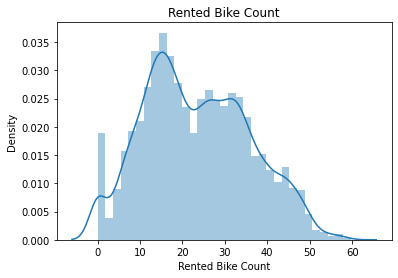

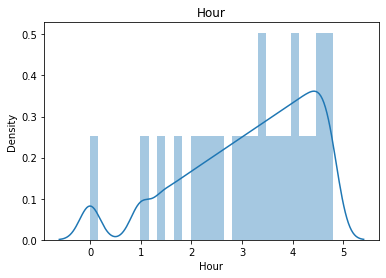

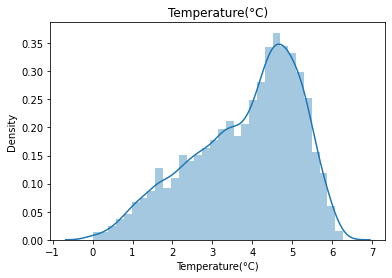

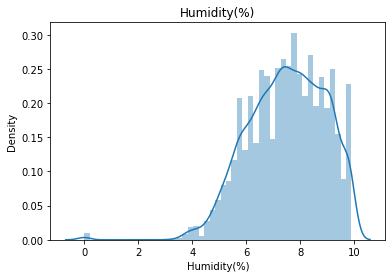

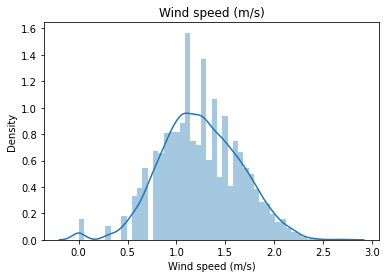

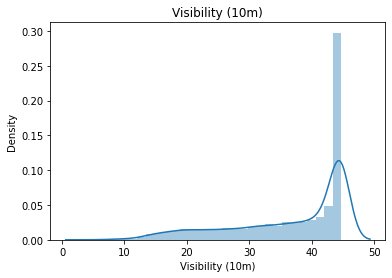

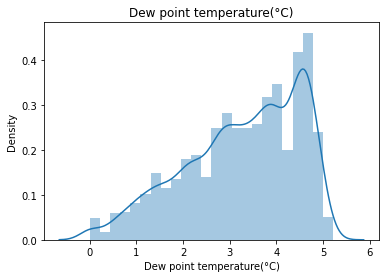

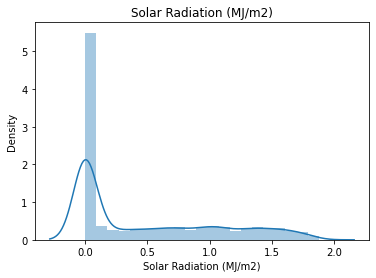

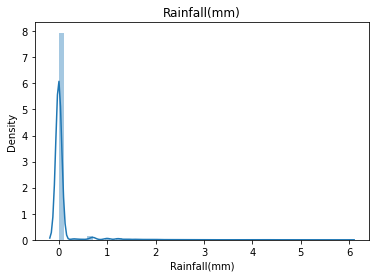

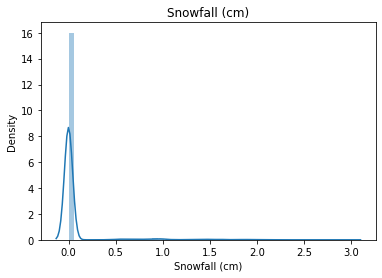

In [ ]:
#Applying square root transformation:
for column in data.columns[1:-3]:
    sns.distplot(np.sqrt(data[column]))
    plt.title(column)
    plt.show()

#As the effect of square root transformation is not affecting the data so much or we can say that we can approach further with our original dataset without transformation.

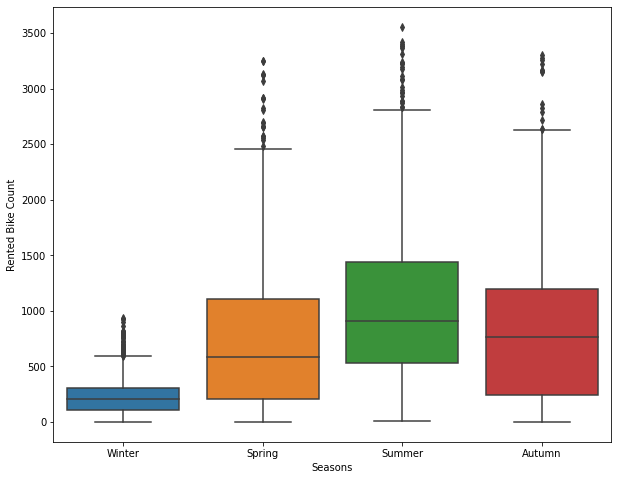

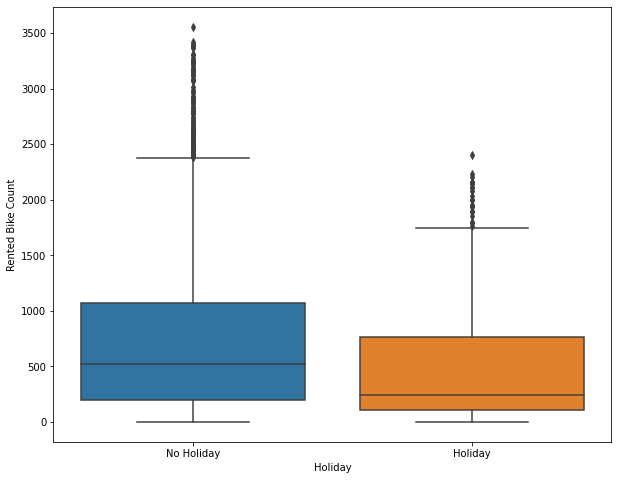

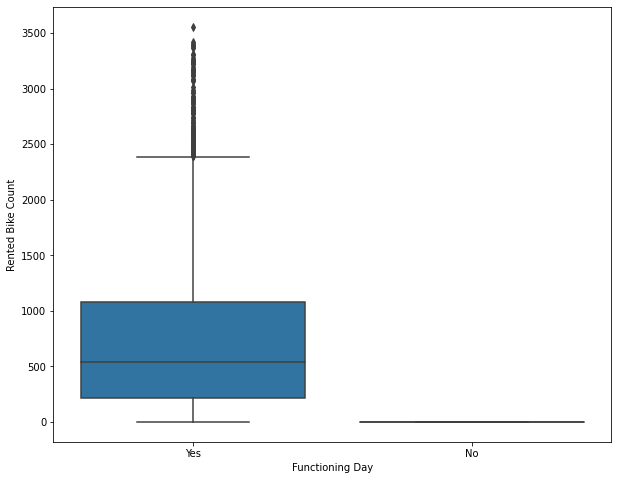

In [ ]:
#Now time to focus to our categorical data so ploting Box plot to visualize and trying to get information from plot
for col in data.columns[-3:]:
  plt.figure(figsize=(10,8))
  sns.boxplot(x=data[col],y=data["Rented Bike Count"])
  plt.show()

#From the above boxplots, it is seen that a very high demand of rented bike is seen in summer season and very low demand seen in winter season.most of the demand are on working days and a few in holidays.

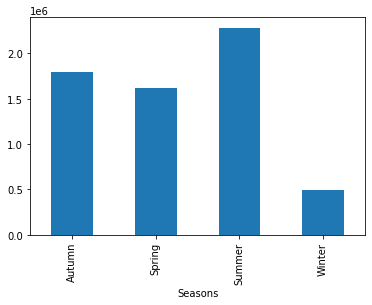

In [ ]:
#the above statement is clearly understood in the below bar graph:
data.groupby('Seasons').sum()['Rented Bike Count'].plot(kind='bar')


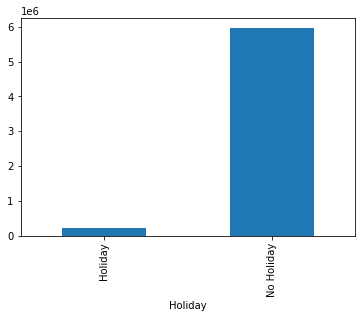

In [ ]:
#Let us plot the bar graph of holiday column:
data.groupby('Holiday').sum()['Rented Bike Count'].plot(kind='bar')

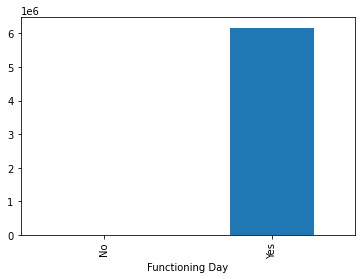

In [ ]:
#bar plot of functioning day column
data.groupby('Functioning Day').sum()['Rented Bike Count'].plot(kind='bar')

#Bivariate Analysis

In [ ]:
#ploting line graph
# group by Hrs and get average Bikes rented, and precent change
avg_rent_hrs = data.groupby('Hour')['Rented Bike Count'].mean()

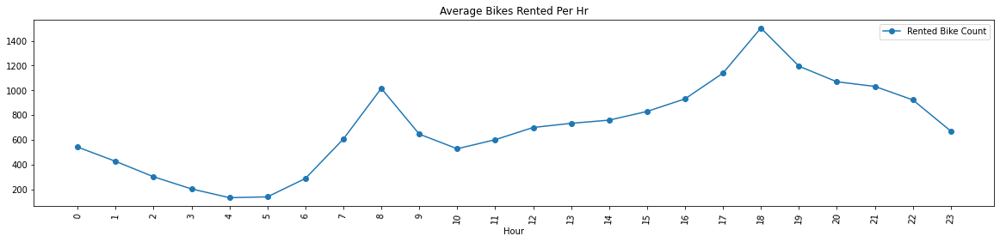

In [ ]:
# plot average rent over time(hrs)
plt.figure(figsize=(20,4))
a=avg_rent_hrs.plot(legend=True,marker='o',title="Average Bikes Rented Per Hr")
a.set_xticks(range(len(avg_rent_hrs)));
a.set_xticklabels(avg_rent_hrs.index.tolist(), rotation=85);

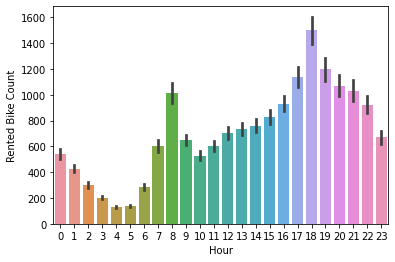

In [ ]:
#bar plot of 'hour' vs 'rented bike count' using seaborn
sns.barplot(x='Hour',y='Rented Bike Count',data=data)

# From the above two plots it can clearly noticed that rented bike count is in demand during time slot of 8am to 10am and 5pm to 8pm and a very high demand at 6pm. we can say that most of the demands are from office going persons and students. 

<Figure size 4000x1600 with 0 Axes>

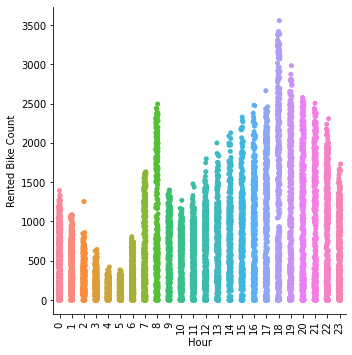

<Figure size 4000x1600 with 0 Axes>

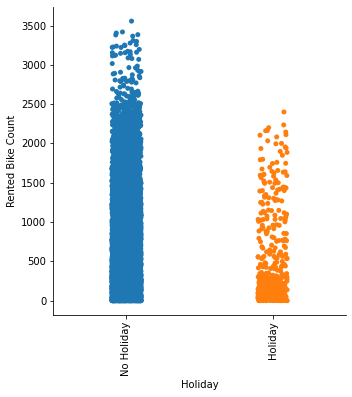

<Figure size 4000x1600 with 0 Axes>

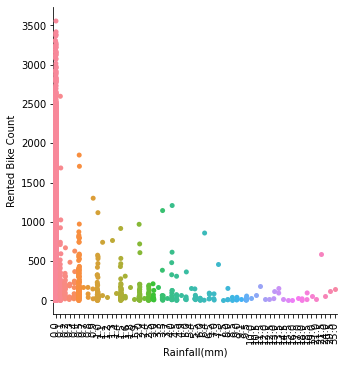

<Figure size 4000x1600 with 0 Axes>

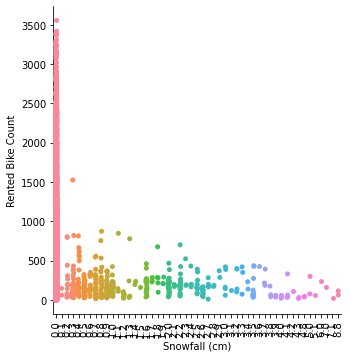

In [ ]:
# ploting cat plot on some feature to get more information

feature_list=["Hour","Holiday",'Rainfall(mm)','Snowfall (cm)']
for feature in feature_list:
  plt.figure(figsize=(20,8),dpi=200)
  sns.catplot(x=feature,y='Rented Bike Count',data=data)
  plt.xticks(rotation=90)
  plt.show()

# Now let us check linearty of each column with our target column

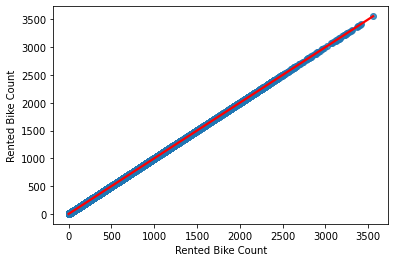

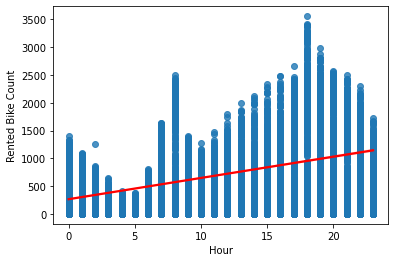

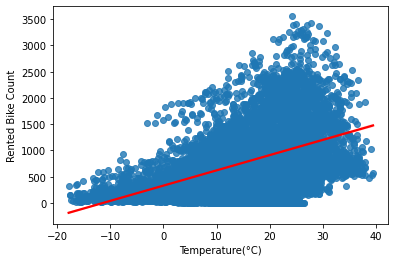

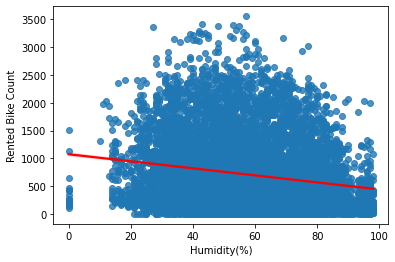

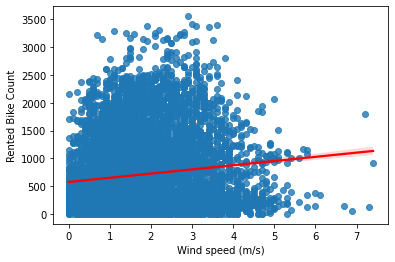

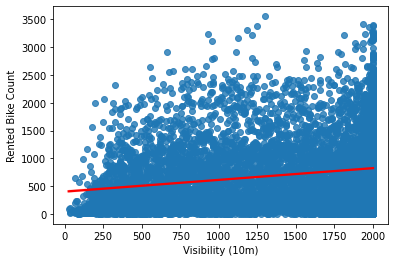

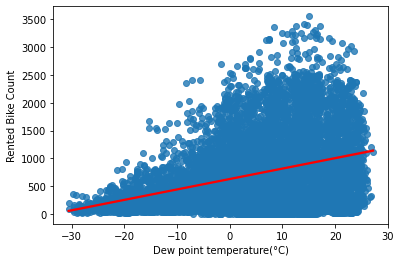

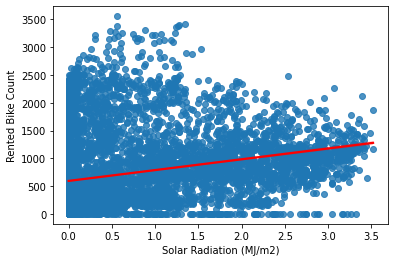

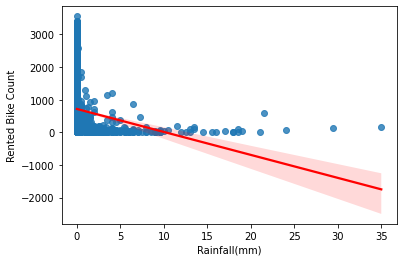

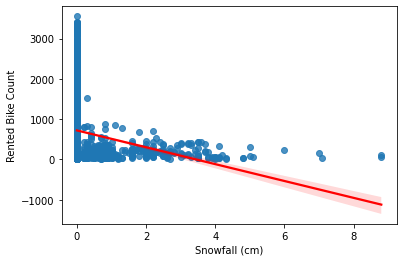

In [ ]:
for column in data.columns[1:-3]:
  sns.regplot(x=data[column],y=data['Rented Bike Count'],data=data,line_kws={"color": "red"})
  
  plt.show()

#It is seen that most of the features are showing linear relation with our target feature

#Multivariate visualization

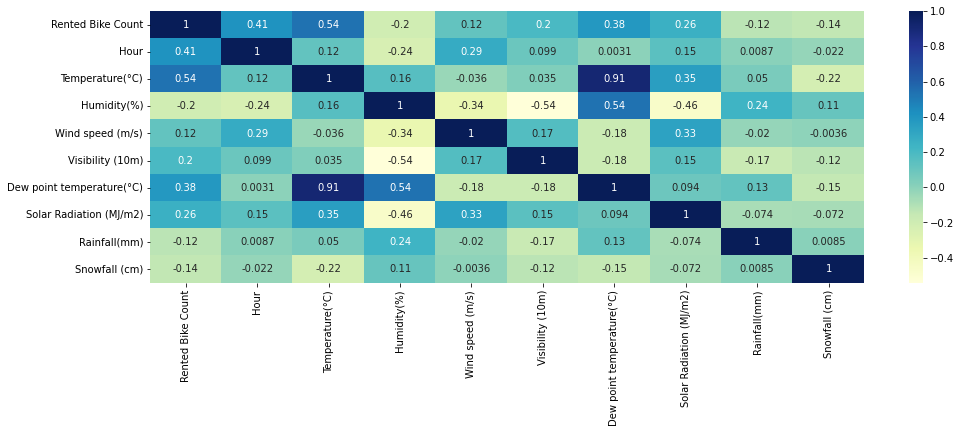

In [ ]:
plt.figure(figsize=(16,5))
dataplot = sns.heatmap(data.corr(), cmap="YlGnBu", annot=True)
plt.show()

#From the heatmap, i have observed that 'rented bike count' or target feature is showing a high correlation with 'temperature' and 'hour' and low correlation with other features. Moreover,dew point is also having high corelation with 'temperature' and 'humidity'. 

#Feature Engineering

In [ ]:
# converting datatype of date from object datatype to datetime datatype and extracting month and year information.
data['Date']=pd.to_datetime(data['Date'], infer_datetime_format=True)

In [ ]:
#Extracting year and month:
data['year'] = pd.DatetimeIndex(data['Date']).year
data['month'] = pd.DatetimeIndex(data['Date']).month


In [ ]:
#drop date column since we have extracted what we need for analysis
data.drop(columns='Date',inplace=True,axis=1)


In [ ]:
# again looking into dataset to confirm whether changes are applied or not
data.head()

,Rented Bike Count,Hour,Temperature(°C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(°C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Seasons,Holiday,Functioning Day,year,month
0,254,0,-5.2,37,2.2,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes,2017,1
1,204,1,-5.5,38,0.8,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes,2017,1
2,173,2,-6.0,39,1.0,2000,-17.7,0.0,0.0,0.0,Winter,No Holiday,Yes,2017,1
3,107,3,-6.2,40,0.9,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes,2017,1
4,78,4,-6.0,36,2.3,2000,-18.6,0.0,0.0,0.0,Winter,No Holiday,Yes,2017,1


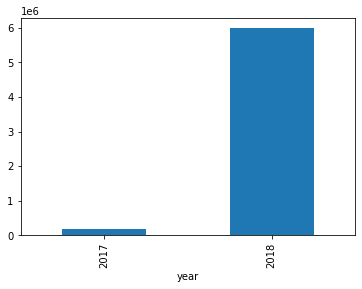

In [ ]:
#bar plotting 'year' vs 'rented bike count'
data.groupby('year').sum()['Rented Bike Count'].plot(kind='bar')

# It is cleared that the rented bike demand has been increased from 2017 to 2018 as the demand is very high in the year 2018 as compared to the previous year 2017.

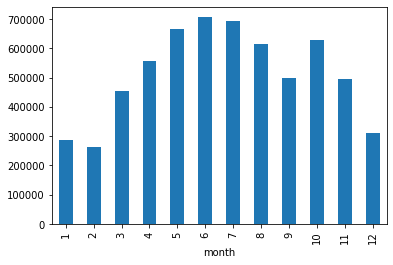

In [ ]:
#bar plotting the 'month' vs 'Rented Bike Count'
data.groupby('month').sum()['Rented Bike Count'].plot(kind='bar')

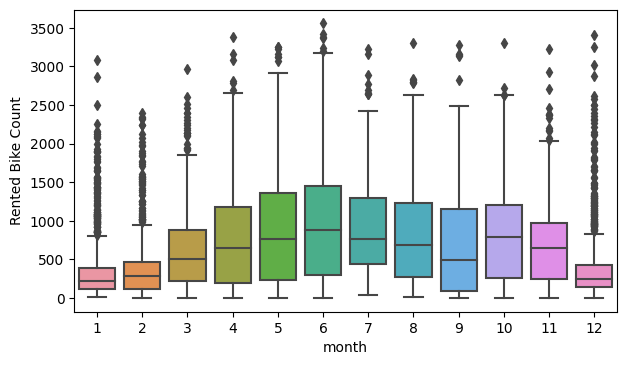

In [ ]:
#another way to visualize 'month' vs 'Rented Bike Count'
plt.figure(figsize=(7,4),dpi=100)
sns.boxplot(x='month',y='Rented Bike Count',data=data)
plt.show()

#From the graph above, we can interpret that rented bike demand is low from december to febrauary and then from march, the demand goes on increasing and maximum in june-july(summer season).

In [ ]:
#converting categorical columns to numerical column as machine learning model unable to understand categorical data
data=pd.get_dummies(data=data,columns=['Seasons','Holiday', 'Functioning Day'],drop_first=True)
data.head()

,Rented Bike Count,Hour,Temperature(°C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(°C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),year,month,Seasons_Spring,Seasons_Summer,Seasons_Winter,Holiday_No Holiday,Functioning Day_Yes
0,254,0,-5.2,37,2.2,2000,-17.6,0.0,0.0,0.0,2017,1,0,0,1,1,1
1,204,1,-5.5,38,0.8,2000,-17.6,0.0,0.0,0.0,2017,1,0,0,1,1,1
2,173,2,-6.0,39,1.0,2000,-17.7,0.0,0.0,0.0,2017,1,0,0,1,1,1
3,107,3,-6.2,40,0.9,2000,-17.6,0.0,0.0,0.0,2017,1,0,0,1,1,1
4,78,4,-6.0,36,2.3,2000,-18.6,0.0,0.0,0.0,2017,1,0,0,1,1,1


# Outlier handling and its treatment

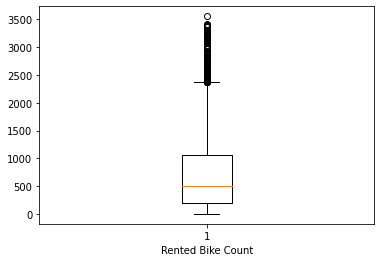

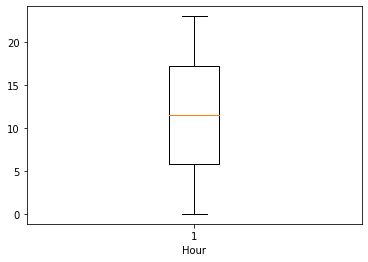

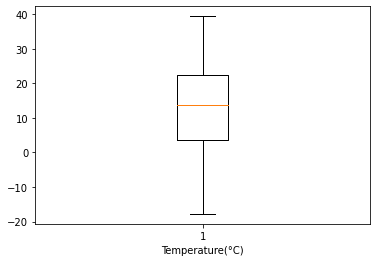

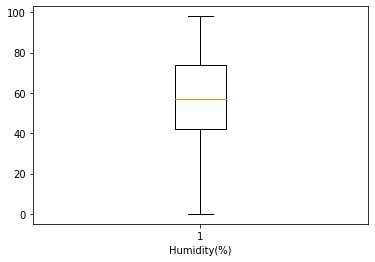

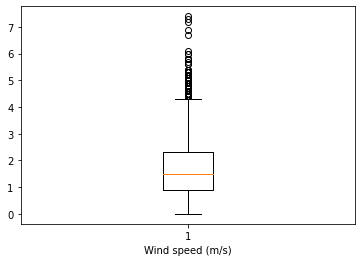

...

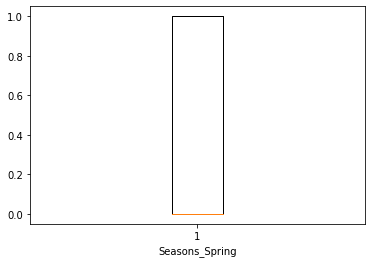

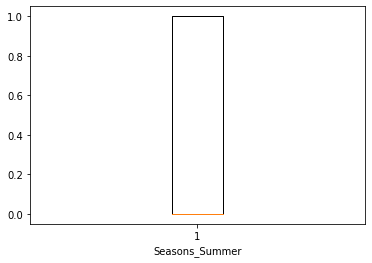

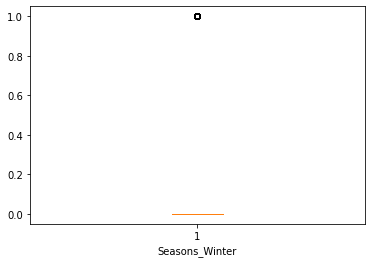

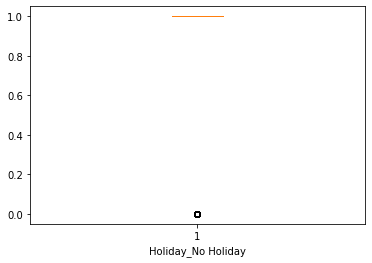

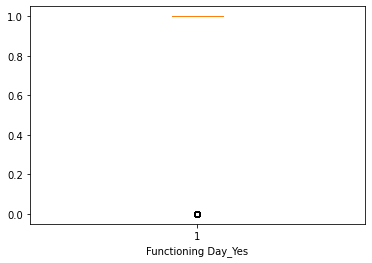

In [ ]:
#let us check outliers in our dataset and for this we need to plot boxplot to clear ourself:
for column in data.columns:
  plt.boxplot(data=data,x=column)
  plt.xlabel(column)
  plt.show()

# outliers are present in our data so we need to handle it,therefore, i am using inter-quantile method to do so.

In [ ]:
#Inter quantile method:
Q1 = data.quantile(0.25)
Q3 = data.quantile(0.75)
IQR = Q3 - Q1
print(IQR)

Rented Bike Count             874.25
Hour                           11.50
Temperature(°C)                19.00
Humidity(%)                    32.00
Wind speed (m/s)                1.40
Visibility (10m)             1060.00
Dew point temperature(°C)      19.50
Solar Radiation (MJ/m2)         0.93
Rainfall(mm)                    0.00
Snowfall (cm)                   0.00
year                            0.00
month                           6.00
Seasons_Spring                  1.00
Seasons_Summer                  1.00
Seasons_Winter                  0.00
Holiday_No Holiday              0.00
Functioning Day_Yes             0.00
dtype: float64


In [ ]:
list_column=['Wind speed (m/s)','Solar Radiation (MJ/m2)','Rainfall(mm)','Snowfall (cm)']

In [ ]:
data[list_column] = data[list_column][~((data[list_column] < (Q1 - 1.5 * IQR)) |(data[list_column] > (Q3 + 1.5 * IQR))).any(axis=1)]

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 17 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Rented Bike Count          8760 non-null   int64  
 1   Hour                       8760 non-null   int64  
 2   Temperature(°C)            8760 non-null   float64
 3   Humidity(%)                8760 non-null   int64  
 4   Wind speed (m/s)           7078 non-null   float64
 5   Visibility (10m)           8760 non-null   int64  
 6   Dew point temperature(°C)  8760 non-null   float64
 7   Solar Radiation (MJ/m2)    7078 non-null   float64
 8   Rainfall(mm)               7078 non-null   float64
 9   Snowfall (cm)              7078 non-null   float64
 10  year                       8760 non-null   int64  
 11  month                      8760 non-null   int64  
 12  Seasons_Spring             8760 non-null   uint8  
 13  Seasons_Summer             8760 non-null   uint8

# Outliers are successfully removed and thus null values are filled in our datset. Now it is time to handle these null values so i am handling it by replacing the null values with the mean value.

In [ ]:
data['Wind speed (m/s)'] = data['Wind speed (m/s)'].fillna(data['Wind speed (m/s)'].mean())
data['Solar Radiation (MJ/m2)'] = data['Solar Radiation (MJ/m2)'].fillna(data['Solar Radiation (MJ/m2)'].mean())
data['Rainfall(mm)'] = data['Rainfall(mm)'].fillna(data['Rainfall(mm)'].mean())
data['Snowfall (cm)'] = data['Snowfall (cm)'].fillna(data['Snowfall (cm)'].mean())

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 17 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Rented Bike Count          8760 non-null   int64  
 1   Hour                       8760 non-null   int64  
 2   Temperature(°C)            8760 non-null   float64
 3   Humidity(%)                8760 non-null   int64  
 4   Wind speed (m/s)           8760 non-null   float64
 5   Visibility (10m)           8760 non-null   int64  
 6   Dew point temperature(°C)  8760 non-null   float64
 7   Solar Radiation (MJ/m2)    8760 non-null   float64
 8   Rainfall(mm)               8760 non-null   float64
 9   Snowfall (cm)              8760 non-null   float64
 10  year                       8760 non-null   int64  
 11  month                      8760 non-null   int64  
 12  Seasons_Spring             8760 non-null   uint8  
 13  Seasons_Summer             8760 non-null   uint8

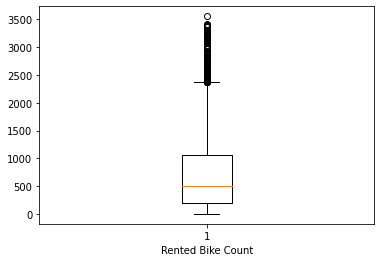

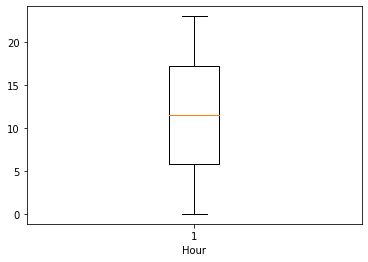

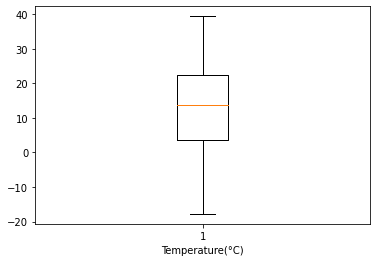

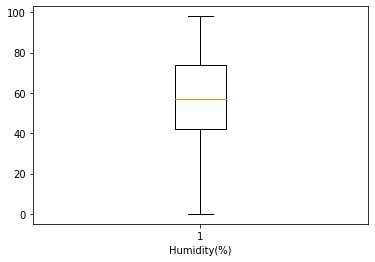

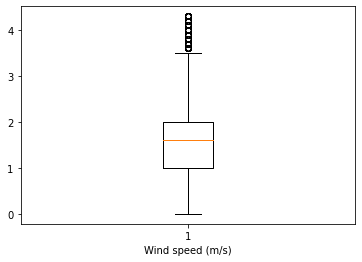

...

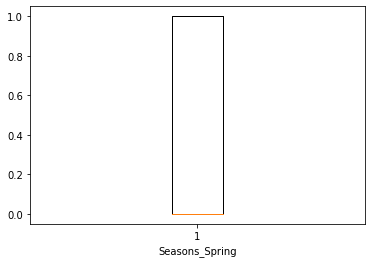

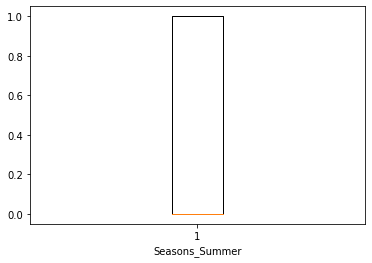

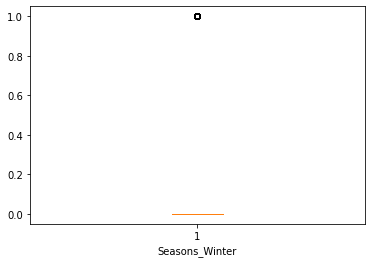

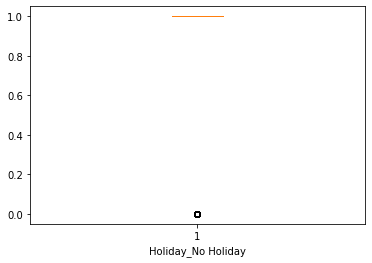

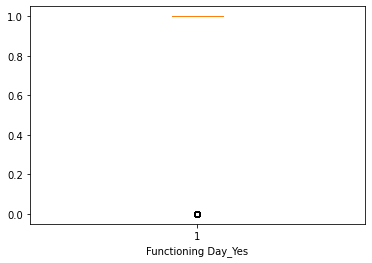

In [ ]:
for column in data.columns:
  plt.boxplot(data=data,x=column)
  plt.xlabel(column)
  plt.show()

# Everything is fine now and it is time to check multicolinearity

# Multicollinearity checking

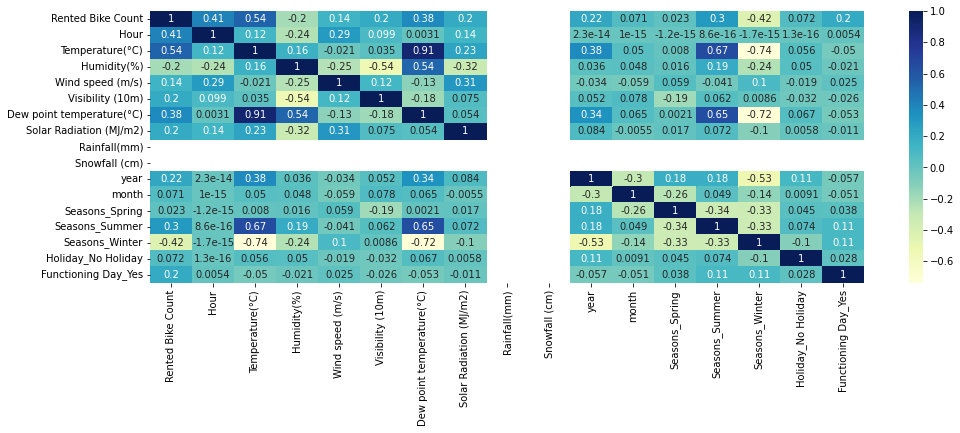

In [ ]:
# First checking corelation using heatmap
plt.figure(figsize=(16,5))
dataplot = sns.heatmap(data.corr(), cmap="YlGnBu", annot=True)
plt.show()

#1) Rented bike count is having positive corelation with temperature and hour.
#2) temperature is showing positive corelation with dew point temperature,season_summer and negative corelation with season_winter.
#3)Humidity is showing positive corelation with dew point temperature and negative corelation with visibility.
#etc


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 17 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Rented Bike Count          8760 non-null   int64  
 1   Hour                       8760 non-null   int64  
 2   Temperature(°C)            8760 non-null   float64
 3   Humidity(%)                8760 non-null   int64  
 4   Wind speed (m/s)           8760 non-null   float64
 5   Visibility (10m)           8760 non-null   int64  
 6   Dew point temperature(°C)  8760 non-null   float64
 7   Solar Radiation (MJ/m2)    8760 non-null   float64
 8   Rainfall(mm)               8760 non-null   float64
 9   Snowfall (cm)              8760 non-null   float64
 10  year                       8760 non-null   int64  
 11  month                      8760 non-null   int64  
 12  Seasons_Spring             8760 non-null   uint8  
 13  Seasons_Summer             8760 non-null   uint8

In [ ]:
#Multicollinearity
from statsmodels.stats.outliers_influence import variance_inflation_factor
def calc_vif(X):

    # Calculating VIF
    vif = pd.DataFrame()
    vif["variables"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

    return(vif)

In [ ]:
multicolinearty=calc_vif(data[[i for i in data.describe().columns if i not in ['Rented Bike Count']]])

In [ ]:
multicolinearty

,variables,VIF
0,Hour,4.520561
1,Temperature(°C),178.648646
2,Humidity(%),180.714859
3,Wind speed (m/s),5.915728
4,Visibility (10m),10.956397
5,Dew point temperature(°C),121.657626
6,Solar Radiation (MJ/m2),2.123801
7,Rainfall(mm),NaN
8,Snowfall (cm),NaN
9,year,449.474138


# since we have mathematical relation between humidity ,temperature and dew point so lets drop dew point temperature as it has very low corelation with our target feature and also some other columns that have low corelation to make the data model ready.

In [ ]:
data.drop(columns=['Dew point temperature(°C)','year','Rainfall(mm)','Snowfall (cm)'],axis=1,inplace=True)

In [ ]:
multicolinearty=calc_vif(data[[i for i in data.describe().columns if i not in ['Rented Bike Count','Dew point temperature(°C)','Rainfall(mm)','Snowfall (cm)','year']]])
multicolinearty

,variables,VIF
0,Hour,4.432672
1,Temperature(°C),9.117895
2,Humidity(%),11.387068
3,Wind speed (m/s),5.835221
4,Visibility (10m),7.548224
5,Solar Radiation (MJ/m2),2.040244
6,month,5.205659
7,Seasons_Spring,2.451220
8,Seasons_Summer,3.337263
9,Seasons_Winter,4.101503


In [ ]:
data.head()

,Rented Bike Count,Hour,Temperature(°C),Humidity(%),Wind speed (m/s),Visibility (10m),Solar Radiation (MJ/m2),month,Seasons_Spring,Seasons_Summer,Seasons_Winter,Holiday_No Holiday,Functioning Day_Yes
0,254,0,-5.2,37,2.2,2000,0.0,1,0,0,1,1,1
1,204,1,-5.5,38,0.8,2000,0.0,1,0,0,1,1,1
2,173,2,-6.0,39,1.0,2000,0.0,1,0,0,1,1,1
3,107,3,-6.2,40,0.9,2000,0.0,1,0,0,1,1,1
4,78,4,-6.0,36,2.3,2000,0.0,1,0,0,1,1,1


# ML Model selection and its implementation

In [ ]:
#importing libraries required for machine learning
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

#Let us build some important function required for our ML

In [ ]:
#creating list of matrices to store the evaluation matrices of all models:
mean_sq_error=[]
root_mean_sq_error=[]
r2_list=[]
adj_r2_list=[]

In [ ]:


def run_model(model,x_train,y_train,x_test,y_test):
    
    # Fit Model
    model.fit(x_train,y_train)
    
    # Get Metrices
    predict_train = model.predict(x_train)
    predict_test = model.predict(x_test)
    
    import math
    from sklearn.metrics import mean_squared_error
    from sklearn.metrics import mean_absolute_error
    from sklearn.metrics import r2_score
    print('\n================Evalution Matrix for training data=============\n')
    MSE  = mean_squared_error(y_train,predict_train)
    print("MSE :" , MSE)
    
    RMSE = np.sqrt(MSE)
    print("RMSE :" ,RMSE)
    r2 = r2_score(y_train,predict_train)
    print("R2 :" ,r2)
    adj_r2=1-(1-r2_score(y_train,predict_train))*((x_train.shape[0]-1)/(x_train.shape[0]-x_train.shape[1]-1))
    print("Adjusted R2 : ",adj_r2)
    print('\n================Evalution Matrix for testing data============\n')
    MSE  = mean_squared_error(y_test,predict_test)
    print("MSE :" , MSE)
    
    RMSE = np.sqrt(MSE)
    print("RMSE :" ,RMSE)
    r2 = r2_score(y_test,predict_test)
    print("R2 :" ,r2)
    adj_r2=1-(1-r2_score(y_test,predict_test))*((x_test.shape[0]-1)/(x_test.shape[0]-x_test.shape[1]-1))
    print("Adjusted R2 : ",adj_r2)

    #train_class_preds = linear_model.predict(X_train)

   

    mean_sq_error.append(MSE)
    root_mean_sq_error.append(RMSE)
    r2_list.append(r2)
    adj_r2_list.append(adj_r2)

    #ploting 
    print('\
    =========================================================\
    Evalution Graph\
    ===================================================\n') 
    plt.figure(figsize=(20,10))
    plt.plot(np.array(y_test[:100]))
    plt.plot(predict_test[:100])    
    plt.legend(["ACTUAL","PREDICTED"],prop={'size': 20})
    plt.show()

In [ ]:
#Make dependent and independent variables for our modelling
dependent_variable= 'Rented Bike Count'
independent_variable=data.drop(columns=['Rented Bike Count']).columns

In [ ]:
independent_variable

Index(['Hour', 'Temperature(°C)', 'Humidity(%)', 'Wind speed (m/s)',
       'Visibility (10m)', 'Solar Radiation (MJ/m2)', 'month',
       'Seasons_Spring', 'Seasons_Summer', 'Seasons_Winter',
       'Holiday_No Holiday', 'Functioning Day_Yes'],
      dtype='object')

In [ ]:
# Create the data of independent variables
X = data[independent_variable].values

# Create the dependent variable data
y = data[dependent_variable].values

In [ ]:
#train test splitting
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

In [ ]:
# Used log1p transformation so that effect of outliers on dependent variable will be as low as possible
y_train=np.log1p(y_train)
y_test=np.log1p(y_test)


In [ ]:
#data scaling
scaler = MinMaxScaler()
x_train = scaler.fit_transform(x_train)
x_test = scaler.transform(x_test)

#Linear regression model

In [ ]:
#fitting the linear regression model
regressor = LinearRegression()



================Evalution Matrix for training data=============

MSE : 0.5836169149550465
RMSE : 0.7639482410183602
R2 : 0.7614529057412875
Adjusted R2 :  0.7610436755581418

================Evalution Matrix for testing data============

MSE : 0.5984593123740051
RMSE : 0.7736015204056964
R2 : 0.7766399573859609
Adjusted R2 :  0.7750986574944322
    =========================================================    Evalution Graph    ===================================================



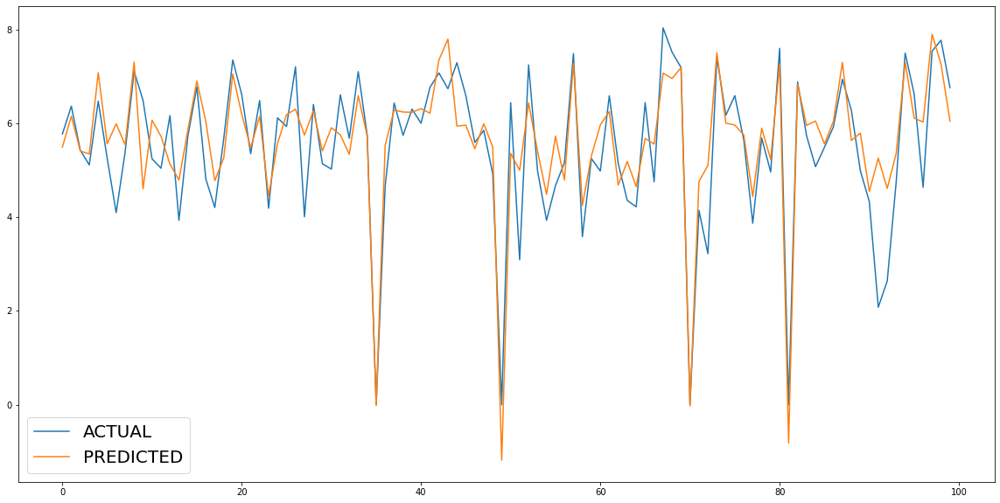

In [ ]:
# using defined function 'run_model' to know evaluation metrices
run_model(regressor,x_train,y_train,x_test,y_test)

#Feature Importance using LIME

In [ ]:
pip install lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#importing libraries for LIME
import lime
import lime.lime_tabular

In [ ]:
# define explainer
explainer = lime.lime_tabular.LimeTabularExplainer(x_train, feature_names=independent_variable,
                                                  class_names=['Rented Bike Count'], verbose=True, mode='regression')

In [ ]:
exp.show_in_notebook(show_table=True)

In [ ]:
j = 10
exp = explainer.explain_instance(x_test[j], linear_fit.predict, num_features=6)

Intercept 4.415018490026181
Prediction_local [4.96488446]
Right: 6.066734212346301


In [ ]:
exp.show_in_notebook(show_table=True)

#Lasso regression model


In [ ]:
#importing lasso regressor model
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV


In [ ]:
#fitting the lasso regressor model
lasso=Lasso()
parameters={'alpha': [0.8,1,10,20,40,80,100,300,700,1000]}
lasso_regressor=GridSearchCV(lasso,parameters,scoring='neg_mean_squared_error',cv=5)
lasso_fit=lasso_regressor.fit(x_train,y_train)
lasso_fit

GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': [0.8, 1, 10, 20, 40, 80, 100, 300, 700,
                                   1000]},
             scoring='neg_mean_squared_error')


================Evalution Matrix for training data=============

MSE : 2.446547994091658
RMSE : 1.5641444927153176
R2 : 0.0
Adjusted R2 :  -0.0017155110793423134

================Evalution Matrix for testing data============

MSE : 2.6854988222476117
RMSE : 1.6387491639197294
R2 : -0.002295592991482742
Adjusted R2 :  -0.009211951309997968
    =========================================================    Evalution Graph    ===================================================



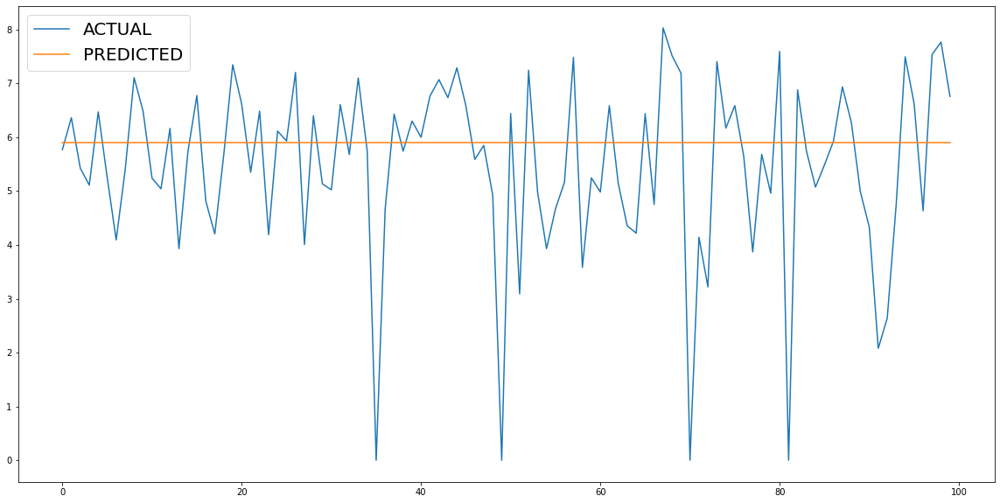

In [ ]:
# using defined function 'run_model' to know evaluation metrices
run_model(lasso_regressor,x_train,y_train,x_test,y_test)

In [ ]:
print("The best fit alpha value for our lasso model is found out to be :" ,lasso_regressor.best_params_)

The best fit alpha value for our lasso model is found out to be : {'alpha': 0.8}


In [ ]:
print("\nUsing ",lasso_regressor.best_params_, " the negative mean squared error is: ", lasso_regressor.best_score_)


Using  {'alpha': 0.8}  the negative mean squared error is:  -2.447137639447438


#Feature Importance

In [ ]:
j = 5
exp = explainer.explain_instance(x_test[j], lasso_fit.predict, num_features=6)

Intercept 5.903208576573147
Prediction_local [5.90320858]
Right: 5.903208576573145


In [ ]:
exp.show_in_notebook(show_table=True)

In [ ]:
j = 10
exp = explainer.explain_instance(x_test[j], lasso_fit.predict, num_features=6)

Intercept 5.903208576573146
Prediction_local [5.90320858]
Right: 5.903208576573145


In [ ]:
exp.show_in_notebook(show_table=True)

#Ridge regressor model

In [ ]:
#Importing ridge regressor model
from sklearn.linear_model import Ridge

In [ ]:
#Fitting the model over train and test set
ridge=Ridge()
parameters={'alpha':[0.0001,0.01,1,10,20,35,70,100,600,1000]}
ridge_regressor=GridSearchCV(ridge,parameters,scoring='neg_mean_squared_error',cv=5)
ridge_fit=ridge_regressor.fit(x_train,y_train)
ridge_fit

GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [0.0001, 0.01, 1, 10, 20, 35, 70, 100, 600,
                                   1000]},
             scoring='neg_mean_squared_error')

In [ ]:
# getting best parameters

print("The best fit alpha value is found out to be :" ,ridge_regressor.best_params_)
print("\nUsing ",ridge_regressor.best_params_, " the negative mean squared error is: ", ridge_regressor.best_score_)

The best fit alpha value is found out to be : {'alpha': 0.01}

Using  {'alpha': 0.01}  the negative mean squared error is:  -0.5858415496797322



================Evalution Matrix for training data=============

MSE : 0.5836169195641279
RMSE : 0.7639482440349791
R2 : 0.7614529038573755
Adjusted R2 :  0.7610436736709979

================Evalution Matrix for testing data============

MSE : 0.5984592327182424
RMSE : 0.7736014689219782
R2 : 0.7766399871154916
Adjusted R2 :  0.775098687429112
    =========================================================    Evalution Graph    ===================================================



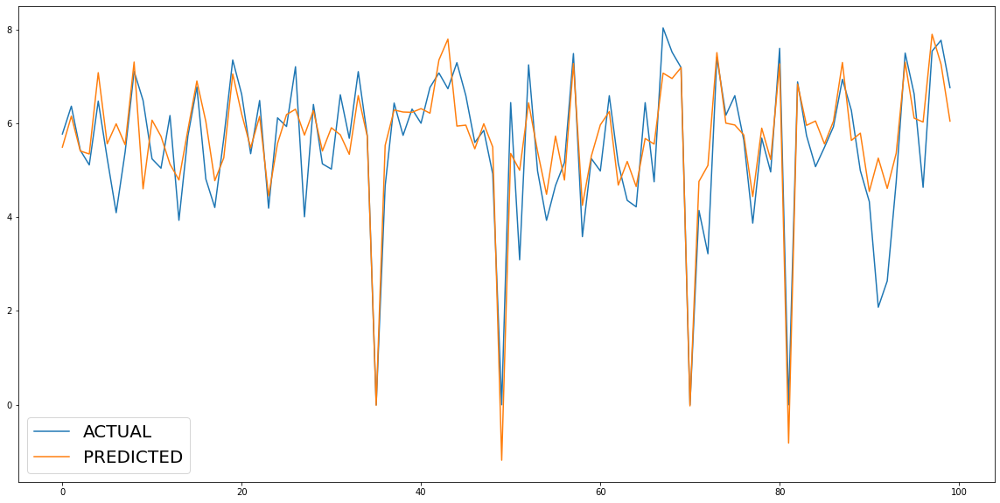

In [ ]:
# using defined function 'run_model' to know evaluation metrices
run_model(ridge_regressor,x_train,y_train,x_test,y_test)

#Feature Importance

In [ ]:
j = 5
exp = explainer.explain_instance(x_test[j], ridge_fit.predict, num_features=6)

Intercept 4.469961246479385
Prediction_local [4.85758697]
Right: 5.562778486312895


In [ ]:
exp.show_in_notebook(show_table=True)

In [ ]:
j = 10
exp = explainer.explain_instance(x_test[j], ridge_fit.predict, num_features=6)

Intercept 4.430265587850127
Prediction_local [4.95393522]
Right: 6.066723516693718


In [ ]:
exp.show_in_notebook(show_table=True)

#Elastic Net Model

In [ ]:
#importing elasticnet model
from sklearn.linear_model import ElasticNet

In [ ]:
#Applying the elasticnet model on the train and test data
elastic_net=ElasticNet()
parameters={'alpha':[1e-15,1e-10,1e-7,1e-4,1e-3,1e-2,1e-1,1,3,5,7,10,15,25,35,80,120],'l1_ratio':[0.3,0.5,0.6,0.7,0.8,1]}
elastic_regressor=GridSearchCV(elastic_net,parameters,scoring='neg_mean_squared_error',cv=5)
elastic_fit=elastic_regressor.fit(x_test,y_test)
elastic_fit

GridSearchCV(cv=5, estimator=ElasticNet(),
             param_grid={'alpha': [1e-15, 1e-10, 1e-07, 0.0001, 0.001, 0.01,
                                   0.1, 1, 3, 5, 7, 10, 15, 25, 35, 80, 120],
                         'l1_ratio': [0.3, 0.5, 0.6, 0.7, 0.8, 1]},
             scoring='neg_mean_squared_error')

In [ ]:
#best fit parameters
print("The best fit alpha value is found out to be :" ,elastic_regressor.best_params_)
print("\nUsing ",elastic_regressor.best_params_, " the negative mean squared error is: ", elastic_regressor.best_score_)

The best fit alpha value is found out to be : {'alpha': 0.001, 'l1_ratio': 1}

Using  {'alpha': 0.001, 'l1_ratio': 1}  the negative mean squared error is:  -0.6046978559803053



================Evalution Matrix for training data=============

MSE : 0.5836169149692553
RMSE : 0.7639482410276597
R2 : 0.76145290573548
Adjusted R2 :  0.7610436755523242

================Evalution Matrix for testing data============

MSE : 0.5984593098987119
RMSE : 0.7736015188058462
R2 : 0.7766399583098025
Adjusted R2 :  0.7750986584246486
    =========================================================    Evalution Graph    ===================================================



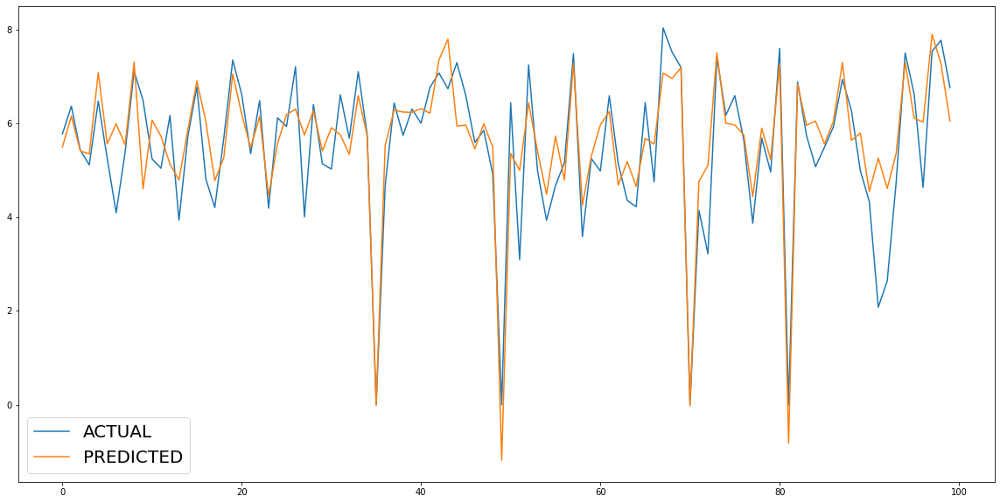

In [ ]:
# using defined function 'run_model' to know evaluation metrices
run_model(elastic_regressor,x_train,y_train,x_test,y_test)

#Feature Importance

In [ ]:
j = 5
exp = explainer.explain_instance(x_test[j], elastic_fit.predict, num_features=6)

Intercept 4.451577385920632
Prediction_local [4.93188326]
Right: 5.5626740732331195


In [ ]:
exp.show_in_notebook(show_table=True)

In [ ]:
j = 10
exp = explainer.explain_instance(x_test[j], elastic_fit.predict, num_features=6)

Intercept 4.48050794037176
Prediction_local [4.8740858]
Right: 6.066733674030748


In [ ]:
exp.show_in_notebook(show_table=True)

#Polynomial Regressor Model

In [ ]:
#creating pipeline to convert x to polynomial feature and apply Linear Regression

from sklearn.pipeline import make_pipeline
#importing polynomial features
from sklearn.preprocessing import PolynomialFeatures

In [ ]:
pipe=make_pipeline(PolynomialFeatures(degree=2),LinearRegression())


================Evalution Matrix for training data=============

MSE : 0.43017970098748504
RMSE : 0.6558808588360275
R2 : 0.824168705446876
Adjusted R2 :  0.823867064912975

================Evalution Matrix for testing data============

MSE : 0.47365612006893343
RMSE : 0.6882267940649605
R2 : 0.8232196425462578
Adjusted R2 :  0.8219997665891302
    =========================================================    Evalution Graph    ===================================================



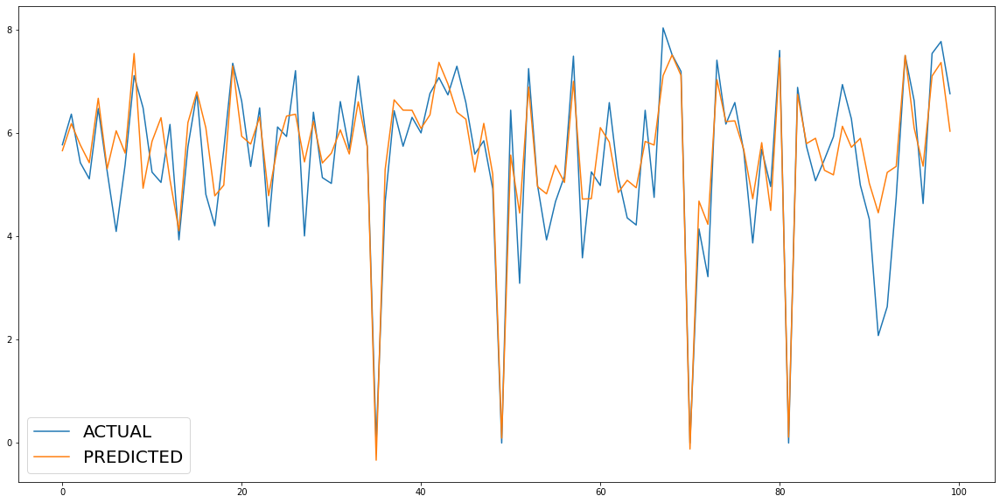

In [ ]:
run_model(pipe,x_train,y_train,x_test,y_test)

#Decision Tree regressor model

In [ ]:
#importing decision tree regressor model
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import accuracy_score

In [ ]:
#Fitting the model over testing and training data
decision_tree=DecisionTreeRegressor()
param={'max_depth': [1,4,5,7,8,10,12,15,20]}
gridsearch_decision_tree=GridSearchCV(decision_tree,param,scoring='r2',cv=5)
decision_tree_fit=gridsearch_decision_tree.fit(x_train,y_train)
decision_tree_fit

GridSearchCV(cv=5, estimator=DecisionTreeRegressor(),
             param_grid={'max_depth': [1, 4, 5, 7, 8, 10, 12, 15, 20]},
             scoring='r2')

In [ ]:
best_decision_tree=gridsearch_decision_tree.best_estimator_
r2_score_decision_tree=gridsearch_decision_tree.score(x_test,y_test)

In [ ]:
print(f"The best R2 score for our Decision Tree  is {gridsearch_decision_tree.best_score_} with max depth {gridsearch_decision_tree.best_params_['max_depth']}")
print('\n')
print(f"The best R2 test score is : {r2_score_decision_tree} with max depth = {gridsearch_decision_tree.best_params_['max_depth']}")

The best R2 score for our Decision Tree  is 0.8858951084737058 with max depth 8


The best R2 test score is : 0.8760382910989213 with max depth = 8



================Evalution Matrix for training data=============

MSE : 0.1958413314223685
RMSE : 0.44253963824991827
R2 : 0.9199519764601718
Adjusted R2 :  0.9198146531889098

================Evalution Matrix for testing data============

MSE : 0.33203890713416045
RMSE : 0.5762281728049753
R2 : 0.8760747424034462
Adjusted R2 :  0.8752195939898989
    =========================================================    Evalution Graph    ===================================================



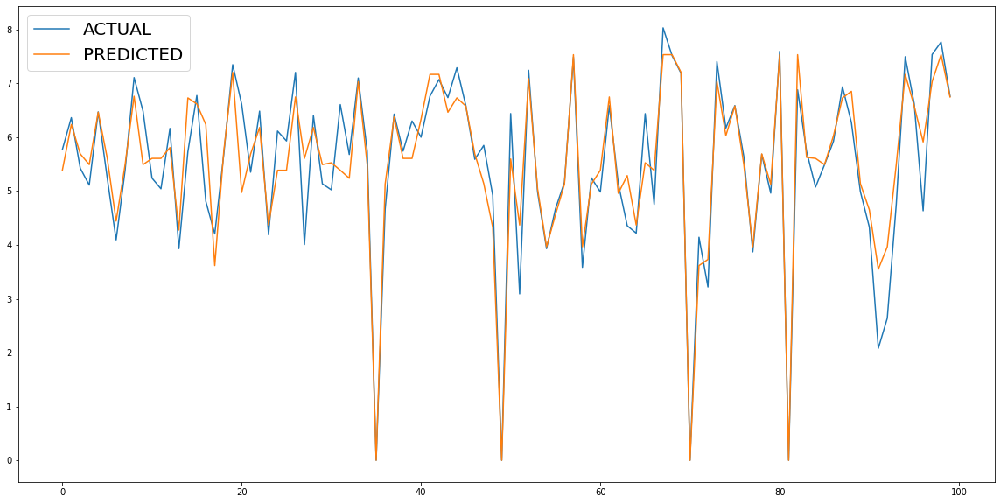

In [ ]:
# using defined function 'run_model' to know evaluation metrices
run_model(gridsearch_decision_tree,x_train,y_train,x_test,y_test)

#Feature Importance

In [ ]:
j = 5
exp = explainer.explain_instance(x_test[j], decision_tree_fit.predict, num_features=6)

Intercept 5.932315153055725
Prediction_local [6.2731992]
Right: 5.620561739993839


In [ ]:
exp.show_in_notebook(show_table=True)

In [ ]:
j = 10
exp = explainer.explain_instance(x_test[j], decision_tree_fit.predict, num_features=6)

Intercept 6.08384232697778
Prediction_local [5.49518472]
Right: 5.607920598973394


In [ ]:
exp.show_in_notebook(show_table=True)

##Random forest regression model

In [ ]:
#importing Random forest regressor model
from sklearn.ensemble import RandomForestRegressor

In [ ]:
# Model fitting
random_forest=RandomForestRegressor()
param = {'n_estimators' : [int(x) for x in np.linspace(start=10,stop=20, num=5)], 
         'max_depth' : [10,15,20],
         'min_samples_split':[2,4],
         'min_samples_leaf':[1,2],
         'bootstrap' : [True,False]
        }
grid_search_random_forest=GridSearchCV(random_forest,param,scoring='r2',cv=5)
random_forest_fit=grid_search_random_forest.fit(x_train,y_train)
random_forest_fit

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'bootstrap': [True, False], 'max_depth': [10, 15, 20],
                         'min_samples_leaf': [1, 2],
                         'min_samples_split': [2, 4],
                         'n_estimators': [10, 12, 15, 17, 20]},
             scoring='r2')

In [ ]:
best_random_forest=grid_search_random_forest.best_estimator_
r2_score_random_forest=best_random_forest.score(x_test,y_test)

In [ ]:
# getting best parameters

print(f"The best Random Forest R2 train score is : {grid_search_random_forest.best_score_} with n estimators = {grid_search_random_forest.best_params_['n_estimators']}, max depth : {grid_search_random_forest.best_params_['max_depth']}, min samples split : {grid_search_random_forest.best_params_['min_samples_split']} and min samples leaf : {grid_search_random_forest.best_params_['min_samples_leaf']}")
print('\n')
print(f"The best Random Forest R2 test score is : {r2_score_random_forest} with n estimators = {grid_search_random_forest.best_params_['n_estimators']}, max depth : {grid_search_random_forest.best_params_['max_depth']}, min samples split : {grid_search_random_forest.best_params_['min_samples_split']} and min samples leaf : {grid_search_random_forest.best_params_['min_samples_leaf']}")

The best Random Forest R2 train score is : 0.9217576425941099 with n estimators = 17, max depth : 20, min samples split : 2 and min samples leaf : 2


The best Random Forest R2 test score is : 0.9199432040644048 with n estimators = 17, max depth : 20, min samples split : 2 and min samples leaf : 2



================Evalution Matrix for training data=============

MSE : 0.02949689901301528
RMSE : 0.17174661281380568
R2 : 0.987943461937289
Adjusted R2 :  0.9879227788126639

================Evalution Matrix for testing data============

MSE : 0.19974828158043115
RMSE : 0.44693207714420224
R2 : 0.9254489256606242
Adjusted R2 :  0.9249344846646078
    =========================================================    Evalution Graph    ===================================================



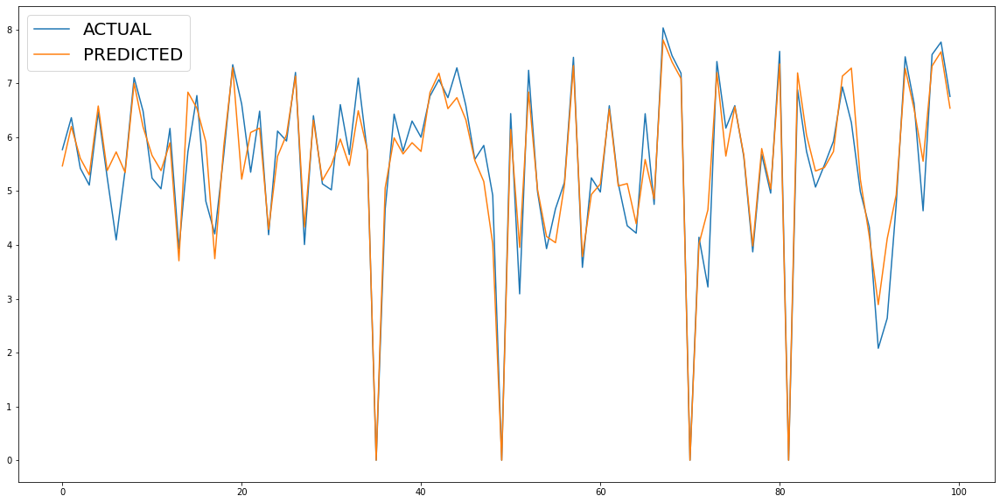

In [ ]:
# using defined function 'run_model' to know evaluation metrices
run_model(grid_search_random_forest,x_train,y_train,x_test,y_test)

#Feature Importance

In [ ]:
j = 5
exp = explainer.explain_instance(x_test[j], random_forest_fit.predict, num_features=6)

Intercept 5.795313699685377
Prediction_local [6.30189494]
Right: 5.382517791191153


In [ ]:
exp.show_in_notebook(show_table=True)

In [ ]:
j = 10
exp = explainer.explain_instance(x_test[j], random_forest_fit.predict, num_features=6)

Intercept 5.995240840786404
Prediction_local [5.31823183]
Right: 5.66378846648896


In [ ]:
exp.show_in_notebook(show_table=True)

#Gradient Booster regressor

In [ ]:
#importing Gradient Boosting Regressor
from sklearn.ensemble import GradientBoostingRegressor

In [ ]:
#creating model of Gradient Boosting
gradient_model=GradientBoostingRegressor()

In [ ]:
# creating param dict to check diffirent value of parameter
n_estimators=[50,80,100,150]
max_depth=[5,10,15,20,30]

params = {'n_estimators':n_estimators,'max_depth':max_depth }

In [ ]:
#grid search for gradient bossting
gradient_grid= GridSearchCV(gradient_model,param_grid=params,verbose=0)
GB_model=gradient_grid.fit(x_train,y_train)
GB_model

GridSearchCV(estimator=GradientBoostingRegressor(),
             param_grid={'max_depth': [5, 10, 15, 20, 30],
                         'n_estimators': [50, 80, 100, 150]})

In [ ]:
best_gradient_value=gradient_grid.best_estimator_
r2_score_gradient=best_gradient_value.score(x_test,y_test)

In [ ]:
best_gradient_value

GradientBoostingRegressor(max_depth=10, n_estimators=150)


================Evalution Matrix for training data=============

MSE : 0.008758821335198539
RMSE : 0.09358857481123718
R2 : 0.9964199266246356
Adjusted R2 :  0.9964137849690954

================Evalution Matrix for testing data============

MSE : 0.20438658775586335
RMSE : 0.4520913489062397
R2 : 0.9237177933286838
Adjusted R2 :  0.9231914066236488
    =========================================================    Evalution Graph    ===================================================



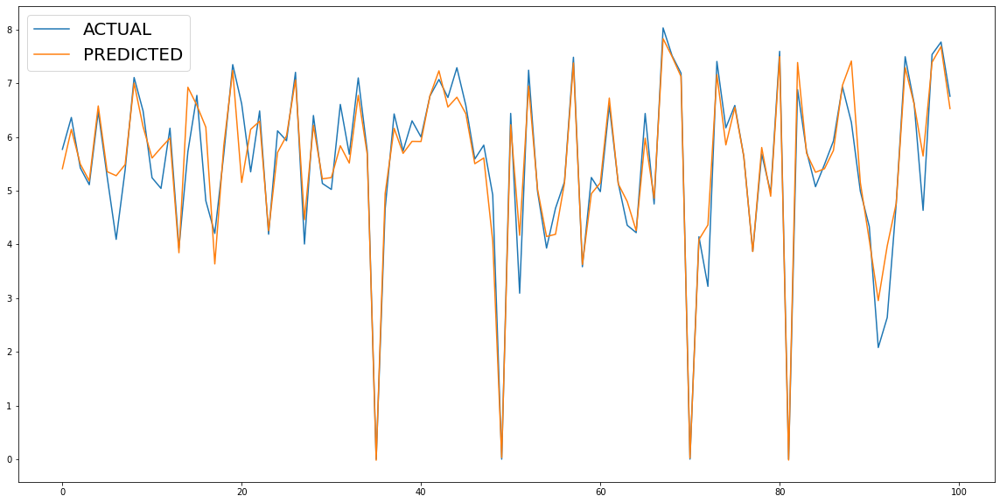

In [ ]:
# using defined function 'run_model' to know evaluation metrices
run_model(gradient_grid,x_train,y_train,x_test,y_test)

#Feauture Importance

In [ ]:
j = 5
exp = explainer.explain_instance(x_test[j], GB_model.predict, num_features=6)

Intercept 5.71240278628485
Prediction_local [6.17766892]
Right: 5.355104604482065


In [ ]:
exp.show_in_notebook(show_table=True)

In [ ]:
j = 10
exp = explainer.explain_instance(x_test[j], GB_model.predict, num_features=6)

Intercept 5.982569221192964
Prediction_local [5.27846448]
Right: 5.609361170450702


In [ ]:
exp.show_in_notebook(show_table=True)

#XG Boosting Regressor model

In [ ]:
#importing XGBoost Regressor
from xgboost import XGBRegressor

#creating Xgboost model
xgb_model=XGBRegressor()

#creating param dict for gridsearch
n_estimators=[20,40,60,80,100,150]
max_depth=[5,8,10,15,20,30]


params = {'n_estimators':n_estimators,'max_depth':max_depth }

#creating xgb grid model
xgb_grid= GridSearchCV(xgb_model,param_grid=params,verbose=0)

#fitting the model over the training dataset:
xgb_model_fit=xgb_grid.fit(x_train,y_train)


[17:08:21] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:08:21] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:08:21] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:08:21] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:08:21] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:08:22] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:08:22] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:08:22] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of re

[17:11:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:11:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:11:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:11:49] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:11:49] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:11:49] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:11:49] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[17:11:49] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of re

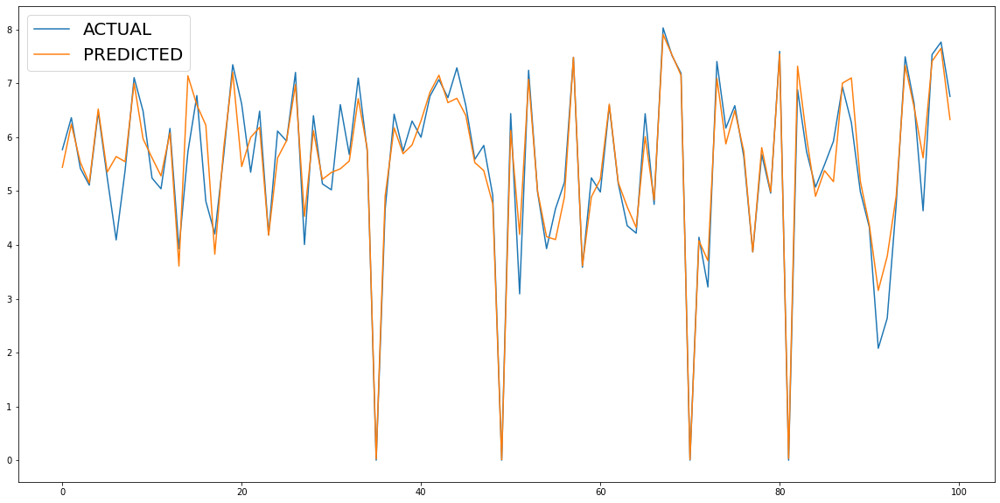

In [ ]:
# using defined function 'run_model' to know evaluation metrices
run_model(xgb_grid,x_train,y_train,x_test,y_test)

#Feature Importance

In [ ]:
j = 5
exp = explainer.explain_instance(x_test[j], xgb_model_fit.predict, num_features=6)

Intercept 5.7096291797246534
Prediction_local [6.0917085]
Right: 5.354107


In [ ]:
exp.show_in_notebook(show_table=True)

In [ ]:
j = 10
exp = explainer.explain_instance(x_test[j], xgb_model_fit.predict, num_features=6)

Intercept 5.933901906654934
Prediction_local [5.16114746]
Right: 5.6192374


In [ ]:
exp.show_in_notebook(show_table=True)

#Final Results for test data of each Model.

In [ ]:
#Making list of models
model_name=['Linear Regression','Lasso regularization','Ridge regularization','Elastic Net regularization','Polynomial Regressor','Decision tree regressor','random forest regressor','Gradient Booster Regressor','XGB Regressor']


In [ ]:
#Creating dataframe
final_model=pd.DataFrame()


In [ ]:
#adding models' evaluation metrices value to visualize properly
final_model['Model Name']=model_name
final_model['Mean Squared Error']=mean_sq_error
final_model['Root Mean Squared Error']=root_mean_sq_error
final_model['R2 Score']=r2_list
final_model['Adjusted R2 Score ']=adj_r2_list


In [ ]:
#final Model visualization
final_model

,Model Name,Mean Squared Error,Root Mean Squared Error,R2 Score,Adjusted R2 Score
0,Linear Regression,0.598459,0.773602,0.776640,0.775099
1,Lasso regularization,2.685499,1.638749,-0.002296,-0.009212
2,Ridge regularization,0.598459,0.773601,0.776640,0.775099
3,Elastic Net regularization,0.598459,0.773602,0.776640,0.775099
4,Polynomial Regressor,0.473656,0.688227,0.823220,0.822000
5,Decision tree regressor,0.332039,0.576228,0.876075,0.875220
6,random forest regressor,0.199748,0.446932,0.925449,0.924934
7,Gradient Booster Regressor,0.204387,0.452091,0.923718,0.923191
8,XGB Regressor,0.182965,0.427744,0.931713,0.931242


# **Data Pipeline:**
# ● Exploratory Data Analysis (EDA): In this part we have done some EDA on the features to see the trend.

# ● Data Processing: In this part we went through each attributes and encoded the categorical features.

# ● Model Creation: Finally in this part we created the various models. These various models are being analysed and we tried to study various models so as to get the best performing model for our project.

# **Observations:**
# ● Observation 1: In the Model Evaluation Matrices table lasso regularization is not giving good result.

# ● Observation 2: linear regresson,ridge regularization & elasticnet have performed equally good in terms of all evaluation metrices.

# ● Observation 3: I got the best results from XGB regressor model but random forest and gradient booster also gave the good results.



#Some key points:
# 1).There is a surge in high demand in the morning 8AM and in evening 6PM as the people might be going to their work in the morning and returing from their work in the evening.

#2).The Temperature, Hour & Humidity are the most important features that positively drive the total rented bikes count.

#3).After performing the various models the XGB regressor,Gradient Booster regressor and random forest among all the models, found to be the best model that can be used for the Bike Sharing Demand Prediction since the performance metrics (mse,rmse) shows lower and (r2,adjusted_r2) shows a higher value for the XGB regressor,Gradient Booster regressor and random forest.



# **Conclusions:**
# ● We started with loading the data, then we did Exploratory Data Analysis (EDA), null values treatment, feature selection, encoding of categorical columns, and then model building. In all of these models, our accuracy ranges from 77% to 93%, which can be said to be good.

#From the exploratory analysis, we saw how clear and sunny weather attracts more riders as compared to rainy and snow weather. We also found that the demand is maximum during morning (7-9 AM) and evening (4-7 PM) travel hours. We also saw how the demand of bikes drop in winter as compared to other seasons and how it has raised in the span of just one year. With the developed model using all these variables, we could have strategically maintained the supply depending on the 30-day weather forecast. And this could have helped our company to reduce the gap between the demand and supply leading to a higher revenue and a better profit margin. This also gives the company scope to change the revenue model by introducing price surge during peak hours based on the forecast of demand.

# ● After fitting so many regressor models into the dataset,, if I consider low RMSE and high R2 score, i got the best results from XGB Regressor and then from random forest and Gradient Booster regressor.

#Therefore, We can use either XGB regressor or random forest model for the bike rental stations.